In [1]:
#!/usr/bin/env python3
# -*- coding: utf-8 -*-
"""
Created on Mon Feb 27 11:11:44 2023

@author: bas
copied from: https://github.com/xpsi-group/xpsi/blob/main/examples/examples_fast/Synthetic_data.ipynb
"""



import os
import numpy as np
import math


from matplotlib import pyplot as plt
from matplotlib import rcParams
from matplotlib.offsetbox import AnchoredText
from matplotlib.ticker import MultipleLocator, AutoLocator, AutoMinorLocator
from matplotlib import gridspec
from matplotlib import cm
from matplotlib.patches import Rectangle
import matplotlib.patches as mpatches


import xpsi
from xpsi import Parameter, HotRegions, Elsewhere
from scipy.interpolate import Akima1DInterpolator
from xpsi.global_imports import _c, _G, _dpr, gravradius, _csq, _km, _2pi
from xpsi.tools.synthesise import synthesise_exposure_no_scaling as _synthesise # no scaling!

import sys
sys.path.append('../')
from custom_tools import CustomInstrumentJ1808, CustomHotRegion, CustomHotRegion_Accreting, CustomHotRegion_Accreting_te_const, CustomPhotosphere_BB, CustomPhotosphere_N4, CustomPhotosphere_N5, CustomPhotosphere_A5, CustomPhotosphere_A4, CustomPrior, CustomPrior_NoSecondary, plot_2D_pulse, CustomBackground_BlackBody, CustomBackground_DiskBB, SynthesiseData, CustomInterstellar, get_T_in_log10_Kelvin, get_mids_from_edges, plot_one_pulse



from custom_tools import sinfunc, fitsin, sin2func, fit2sin

/=============================================\
| X-PSI: X-ray Pulse Simulation and Inference |
|---------------------------------------------|
|                Version: 2.0.0               |
|---------------------------------------------|
|      https://xpsi-group.github.io/xpsi      |
\=============================================/

Imported GetDist version: 1.4
Imported nestcheck version: 0.2.1


In [2]:
class CustomSignal(xpsi.Signal):
    """ A custom calculation of the logarithm of the likelihood.

    We extend the :class:`xpsi.Signal.Signal` class to make it callable.

    We overwrite the body of the __call__ method. The docstring for the
    abstract method is copied.

    """


    def __call__(self, *args, **kwargs):
        # print("running CustomSignal call...")
        self.loglikelihood, self.expected_counts, self.background_signal, self.background_signal_given_support = \
                eval_marginal_likelihood(self._data.exposure_time,
                                          self._data.phases,
                                          self._data.counts,
                                          self._signals,
                                          self._phases,
                                          self._shifts,
                                          self._precomp,
                                          self._support,
                                          self._workspace_intervals,
                                          self._epsabs,
                                          self._epsrel,
                                          self._epsilon,
                                          self._sigmas,
                                          kwargs.get('llzero'))#,
                                          #slim=-1.0) #no 10^89s, so some likelihood calculations are skipped
                                          
    
    def synthesise(self,
                   exposure_time,
                   name='no_pulse',
                   directory='./',
                   **kwargs):
        
            """ Synthesise data set.
    
            """
            self._expected_counts, synthetic = _synthesise(exposure_time,
                                                                       self._data.phases,
                                                                       self._signals,
                                                                       self._phases,
                                                                       self._shifts,
                                                                       self._background.registered_background,
                                                                       gsl_seed=42)
            self.synthetic_data = synthetic
            
            
            try:
                if not os.path.isdir(directory):
                    os.mkdir(directory)
            except OSError:
                print('Cannot create write directory.')
                raise
    
            # np.savetxt(os.path.join(directory, name+'_realisation.dat'),
            #             synthetic,
            #             fmt = '%u')
    
            # self._write(self.expected_counts,
            #             filename = os.path.join(directory, name+'_expected_hreadable.dat'),
            #             fmt = '%.8e')
    
            # self._write(synthetic,
            #             filename = os.path.join(directory, name+'_realisation_hreadable.dat'),
            #             fmt = '%u')

In [3]:


################################## SETTINGS ###################################

second = False
te_index = 0

try: #try to get parameters from shell input
    os.environ.get('atmosphere_type')    
    atmosphere_type = os.environ['atmosphere_type']
    os.environ.get('n_params')
    n_params = os.environ['n_params']
except:
    atmosphere_type = "A"
    n_params = "5"

if atmosphere_type == 'N':
    exposure_time=50000. #Reproducing NSX atmosphere data would require exposure time of 984307.6661
elif atmosphere_type == 'A':
    exposure_time=1.32366e5 ## is the same as Mason 2019
else:
    print('Problem with exposure time!')
print("atmosphere_type:", atmosphere_type)
print("n_params:", n_params)

################################## INSTRUMENT #################################
channel_low = 20
channel_hi = 300 #600
max_input = 1400 #2000

NICER = CustomInstrumentJ1808.from_response_files(ARF = '../model_data/J1808/ni2584010103mpu7_arf_aeff.txt',
                                                  RMF = '../model_data/J1808/ni2584010103mpu7_rmf_matrix.txt',
                                                  channel_edges = '../model_data/J1808/ni2584010103mpu7_rmf_energymap.txt',
                                                  channel_low=channel_low,
                                                  channel_hi=channel_hi,
                                                  max_input=max_input)

############################### SPACETIME #####################################

bounds = dict(distance = (0.1, 10.0),                       # (Earth) distance
                mass = (1.0, 3.0),                          # mass
                radius = (3.0 * gravradius(1.0), 16.0),     # equatorial radius
                cos_inclination = (0.0, 1.0))               # (Earth) inclination to rotation axis

spacetime = xpsi.Spacetime(bounds=bounds, values=dict(frequency=401.0))# Fixing the spin

############################### SINGLE HOTREGION ##############################

num_leaves = 50 # 128
sqrt_num_cells = 90 # 128
num_rays = 512
num_energies = 60 # 128

kwargs = {'symmetry': 'azimuthal_invariance', #call general integrator instead of for azimuthal invariance
          'interpolator': 'split',
          'omit': False,
          'cede': False,
          'concentric': False,
          'sqrt_num_cells': sqrt_num_cells,
          'min_sqrt_num_cells': 10,
          'max_sqrt_num_cells': 128,
          'num_leaves': num_leaves,
          'num_rays': num_rays,
          'prefix': 'p'}
values = {}
bounds = dict(super_colatitude = (None, None),
              super_radius = (None, None),
              phase_shift = (0.0, 0.1))
if atmosphere_type=='A':
    bounds['super_tbb'] = (0.001, 0.003)
    bounds['super_tau'] = (0.5, 3.5)
    if n_params=='5':
        bounds['super_te'] = (40., 200.)
        primary = CustomHotRegion_Accreting(bounds, values, **kwargs)
    elif n_params=='4':    
        primary = CustomHotRegion_Accreting_te_const(bounds, values, **kwargs)
elif atmosphere_type=='N':
    bounds['super_temperature'] = (5.1, 6.8)
    if n_params=='4':
        primary = xpsi.HotRegion(bounds, values, **kwargs)
    elif n_params=='5':
        kwargs['modulated'] = True
        bounds['super_modulator'] = (-0.3, 0.3)
        primary = CustomHotRegion(bounds, values, **kwargs)
elif atmosphere_type=='B':
    bounds['super_temperature'] = (5.1, 6.8)
    primary = CustomHotRegion(bounds, values, **kwargs)

hot = HotRegions((primary,))


################################### ELSEWHERE ################################

elsewhere = Elsewhere(bounds=dict(elsewhere_temperature = (None,None)))

################################ ATMOSPHERE ################################### 
      

photosphere = CustomPhotosphere_A5(hot = hot, elsewhere = elsewhere,
                                values=dict(mode_frequency = spacetime['frequency']))
# LOCAL
photosphere.hot_atmosphere = '/home/bas/Documents/Projects/x-psi/model_datas/bobrikova/Bobrikova_compton_slab.npz'
# SNELLIUS
#photosphere.hot_atmosphere = '/home/dorsman/xpsi-bas-fork/AMXPs/model_data/Bobrikova_compton_slab.npz'

    
################################### STAR ######################################

star = xpsi.Star(spacetime = spacetime, photospheres = photosphere)

#################################### PRIOR ####################################

prior = CustomPrior_NoSecondary()

################################## INTERSTELLAR ###################################

interstellar = CustomInterstellar.from_SWG("/home/bas/Documents/Projects/x-psi/xpsi-bas-fork/AMXPs/model_data/n_H/TBnew/tbnew0.14.txt", bounds=(None, None), value=None)

############################### BACKGROUND ####################################

background = CustomBackground_DiskBB(bounds=(None, None), values={}, interstellar = interstellar)

###################### SYNTHESISE DATA #################################

phases_space = np.linspace(0.0, 1.0, 33)
_data = SynthesiseData(np.arange(channel_low,channel_hi), phases_space, 0, channel_hi-channel_low-1)

################################## SIGNAL ###################################

signal = CustomSignal(data = _data,
                        instrument = NICER, #Instrument
                        background = background,
                        interstellar = interstellar,
                        cache = True,
                        prefix='Instrument') # I can't change this?                          


################################# LIKELIHOOD ###############################

likelihood = xpsi.Likelihood(star = star, signals = signal,
                             num_energies=num_energies, #384
                             threads=8, #1
                             externally_updated=False,
                             prior = prior)                             

for h in hot.objects:
    h.set_phases(num_leaves)


print("Prossecco ...")

# SAX J1808-like 
mass = 1.4
radius = 12.
distance = 3.5
inclination = 60
cos_i = math.cos(inclination*math.pi/180)

# Hotspot
phase_shift = 0
super_colatitude = 45*math.pi/180 # 20*math.pi/180 # 5*math.pi/180 
super_radius = 15.5*math.pi/180 # 40*math.pi/180 #  0.001 #

# Compton slab model parameters
tbb=0.0012 # 0.0015 #0.001 -0.003 Tbb(data) = Tbb(keV)/511keV, 1 keV = 0.002 data
te=100. #40-200 corresponds to 20-100 keV (Te(data) = Te(keV)*1000/511keV), 50 keV = 100 data
tau=1. #0.5 - 3.5 tau = ln(Fin/Fout)

# elsewhere
elsewhere_T_keV =  0.4 #0.5 # 0.5 keV for Kajava+ 2011

# source background
column_density = 1.17 #10^21 cm^-2
diskbb_T_keV = 0.25 #0.3 #keV #0.3 keV for Kajava+ 2011
r_in = 30 # 25 # 1 #  km #  for very small diskBB background

p = [mass, #1.4, #grav mass
      radius,#12.5, #coordinate equatorial radius
      distance, # earth distance kpc
      cos_i, #cosine of earth inclination
      phase_shift, #phase of hotregion
      super_colatitude, #colatitude of centre of superseding region
      super_radius,  #angular radius superceding region
      tbb,
      te,
      tau
      ]

elsewhere_T_log10_K = get_T_in_log10_Kelvin(elsewhere_T_keV)
p.append(elsewhere_T_log10_K) # 10^x Kelvin

diskbb_T_log10_K = get_T_in_log10_Kelvin(diskbb_T_keV)
p.append(diskbb_T_log10_K)

K_disk = cos_i*(r_in/(distance/10))**2  # (km / 10 kpc)^2
print(K_disk)
print('cos_i', cos_i)
print('r_in', r_in)
print('distance', distance)

p.append(K_disk)

if isinstance(interstellar, xpsi.Interstellar):

    p.append(column_density)

Instrument_kwargs = dict(exposure_time=exposure_time,
                         name='J1808_synthetic',
                         directory='./data/')



atmosphere_type: A
n_params: 5
Setting channels for loaded instrument response (sub)matrix...
Channels set.
No parameters supplied... empty subspace created.
Creating parameter:
    > Named "frequency" with fixed value 4.010e+02.
    > Spin frequency [Hz].
Creating parameter:
    > Named "mass" with bounds [1.000e+00, 3.000e+00].
    > Gravitational mass [solar masses].
Creating parameter:
    > Named "radius" with bounds [4.430e+00, 1.600e+01].
    > Coordinate equatorial radius [km].
Creating parameter:
    > Named "distance" with bounds [1.000e-01, 1.000e+01].
    > Earth distance [kpc].
Creating parameter:
    > Named "cos_inclination" with bounds [0.000e+00, 1.000e+00].
    > Cosine of Earth inclination to rotation axis.
Creating parameter:
    > Named "super_tbb" with bounds [1.000e-03, 3.000e-03].
    > tbb.
Creating parameter:
    > Named "super_te" with bounds [4.000e+01, 2.000e+02].
    > te.
Creating parameter:
    > Named "super_tau" with bounds [5.000e-01, 3.500e+00].
    

In [4]:
print(likelihood)

Free parameters
---------------
mass: Gravitational mass [solar masses].
radius: Coordinate equatorial radius [km].
distance: Earth distance [kpc].
cos_inclination: Cosine of Earth inclination to rotation axis.
p__phase_shift: The phase of the hot region, a periodic parameter [cycles].
p__super_colatitude: The colatitude of the centre of the superseding region [radians].
p__super_radius: The angular radius of the (circular) superseding region [radians].
p__super_tbb: tbb.
p__super_te: te.
p__super_tau: tau.
elsewhere_temperature: log10 of the effective temperature elsewhere.
Instrument__T_in: Temperature at inner disk radius in log10 Kelvin.
Instrument__K_disk: Disk normalisation cos_i*R_in^2/D^2 in (km / 10 kpc)^2.
Instrument__column_density: Units of 10^21 cm^-2.



In [5]:
energy_mids = get_mids_from_edges(NICER.channel_edges)
phase_mids = get_mids_from_edges(phases_space)
counts = []

In [6]:
# masses = [1., 1.3, 1.7]

# for mass in masses:
#     p[0] = mass
#     likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
#     counts.append(likelihood.signal.synthetic_data)

# radii = [10., 11., 12.]

# for radius in radii:
#     p[1] = radius
#     likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
#     counts.append(likelihood.signal.synthetic_data)

# inclinations = [10., 30., 60.]

# for inclination in inclinations:
#     cos_i = math.cos(inclination*math.pi/180)
#     p[3] = cos_i
#     likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
#     counts.append(likelihood.signal.synthetic_data)

# super_colatitudes = [10, 20, 30, 40, 45]

# for super_colatitude in super_colatitudes:
#     super_colatitude *= math.pi/180
#     p[5] = super_colatitude
#     likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
#     counts.append(likelihood.signal.synthetic_data)

# super_radii = [1, 15.5, 40]

# for super_radius in super_radii:
#     super_radius *= math.pi/180
#     p[6] = super_radius
#     likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
#     counts.append(likelihood.signal.synthetic_data)

# tbbs = [0.0015, 0.002, 0.0025] #0.001 -0.003 Tbb(data) = Tbb(keV)/511keV, 1 keV = 0.002 data

# for tbb in tbbs:
#     p[7] = tbb
#     likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
#     counts.append(likelihood.signal.synthetic_data)

# tes = [60, 100, 200] #0.001 -0.003 Tbb(data) = Tbb(keV)/511keV, 1 keV = 0.002 data

# for te in tes:
#     p[8] = te
#     likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
#     counts.append(likelihood.signal.synthetic_data)

# taus = [0.5, 1., 2.] #0.001 -0.003 Tbb(data) = Tbb(keV)/511keV, 1 keV = 0.002 data

# for tau in taus:
#     p[9] = tau
#     likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
#     counts.append(likelihood.signal.synthetic_data)

# elsewhere_T_keVs =  [0.3, 0.4, 0.5] # 0.5 keV for Kajava+ 2011

# for elsewhere_T_keV in elsewhere_T_keVs:
#     elsewhere_T_log10_K = get_T_in_log10_Kelvin(elsewhere_T_keV)
#     p[10] = elsewhere_T_log10_K = get_T_in_log10_Kelvin(elsewhere_T_keV)
#     likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
#     counts.append(likelihood.signal.synthetic_data)

# diskbb_T_keVs = [0.2, 0.3, 0.5]

# for diskbb_T_keV in diskbb_T_keVs:
#     diskbb_T_log10_K = get_T_in_log10_Kelvin(diskbb_T_keV)
#     p[11] = diskbb_T_log10_K
#     likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
#     counts.append(likelihood.signal.synthetic_data)

# r_ins = [20, 40, 64]

# for r_in in r_ins:
#     K_disk = cos_i*(r_in/(distance/10))**2
#     p[12] = K_disk
#     likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
#     counts.append(likelihood.signal.synthetic_data)

In [7]:
# NESTED PARAMETER OPTIONS

# tbbs = [0.0012, 0.00135, 0.0015]# [0.0015, 0.002, 0.0025] # #0.001 -0.003 Tbb(data) = Tbb(keV)/511keV, 1 keV = 0.002 data
# elsewhere_T_keVs =  [0.35, 0.4, 0.45]#[0.3, 0.4, 0.5] # # 0.5 keV for Kajava+ 2011
# diskbb_T_keVs = [0.2, 0.25, 0.3]#[0.2, 0.3, 0.5] #
# r_ins = [20, 25, 30]#[20, 40, 64] #


# i = 0
# for tbb in tbbs:
#     p[7] = tbb
#     for elsewhere_T_keV in elsewhere_T_keVs:
#         elsewhere_T_log10_K = get_T_in_log10_Kelvin(elsewhere_T_keV)
#         p[10] = elsewhere_T_log10_K = get_T_in_log10_Kelvin(elsewhere_T_keV)
#         for diskbb_T_keV in diskbb_T_keVs:
#             diskbb_T_log10_K = get_T_in_log10_Kelvin(diskbb_T_keV)
#             p[11] = diskbb_T_log10_K
#             for r_in in r_ins:
#                 K_disk = cos_i*(r_in/(distance/10))**2
#                 p[12] = K_disk
#                 i +=1
#                 print(i)
#                 likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
#                 counts.append(likelihood.signal.synthetic_data)

In [8]:
# labels = []
# for tbb in tbbs:
#     for elsewhere_T_keV in elsewhere_T_keVs:
#         for diskbb_T_keV in diskbb_T_keVs:
#             for r_in in r_ins:
#                 labels.append(f'tbb={tbb}, T_else={elsewhere_T_keV}, T_disk={diskbb_T_keV}, r_in={r_in}')

# for label in labels:
#     print(label)

In [9]:
# Opposing search
# masses = [1.2, 1.4, 1.6]
# radii = [10.,11., 12.]
# inclinations = [10, 30, 60]
# super_radii = [15.5, 40]
# taus = [0.5, 1., 2.]
# tes = [60, 100] #0.001 -0.003 Tbb(data) = Tbb(keV)/511keV, 1 keV = 0.002 data

# fine opposing search
masses = [1.3, 1.4]
radii = [11.,12.]
inclinations = [50, 60, 70]
super_radii = [10, 15.5, 20]
taus = [0.75, 1., 1.25]
tes = [80, 100] #0.001 -0.003 Tbb(data) = Tbb(keV)/511keV, 1 keV = 0.002 data

i = 0
for mass in masses:
    p[0] = mass
    for radius in radii:
        p[1] = radius
        for inclination in inclinations:
            cos_i = math.cos(inclination*math.pi/180)
            p[3] = cos_i 
            p[12] = cos_i*(r_in/(distance/10))**2
            for super_radius in super_radii:
                super_radius *= math.pi/180
                p[6] = super_radius
                for tau in taus:
                    p[9] = tau
                    for te in tes:
                        p[8] = te
                        likelihood.synthesise(p, force=True, Instrument=Instrument_kwargs)
                        counts.append(likelihood.signal.synthetic_data)
                        i +=1
                        print(i)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216


In [10]:
labels = []
for mass in masses:
    for radius in radii:
        for inclination in inclinations:
            for super_radius in super_radii:
                for tau in taus:
                    for te in tes:
                        labels.append(f'mass={mass}, radius={radius}, i={inclination}, s_radius={super_radius}, tau={tau}, te={te}')

for label in labels:
    print(label)

mass=1.3, radius=11.0, i=50, s_radius=10, tau=0.75, te=80
mass=1.3, radius=11.0, i=50, s_radius=10, tau=0.75, te=100
mass=1.3, radius=11.0, i=50, s_radius=10, tau=1.0, te=80
mass=1.3, radius=11.0, i=50, s_radius=10, tau=1.0, te=100
mass=1.3, radius=11.0, i=50, s_radius=10, tau=1.25, te=80
mass=1.3, radius=11.0, i=50, s_radius=10, tau=1.25, te=100
mass=1.3, radius=11.0, i=50, s_radius=15.5, tau=0.75, te=80
mass=1.3, radius=11.0, i=50, s_radius=15.5, tau=0.75, te=100
mass=1.3, radius=11.0, i=50, s_radius=15.5, tau=1.0, te=80
mass=1.3, radius=11.0, i=50, s_radius=15.5, tau=1.0, te=100
mass=1.3, radius=11.0, i=50, s_radius=15.5, tau=1.25, te=80
mass=1.3, radius=11.0, i=50, s_radius=15.5, tau=1.25, te=100
mass=1.3, radius=11.0, i=50, s_radius=20, tau=0.75, te=80
mass=1.3, radius=11.0, i=50, s_radius=20, tau=0.75, te=100
mass=1.3, radius=11.0, i=50, s_radius=20, tau=1.0, te=80
mass=1.3, radius=11.0, i=50, s_radius=20, tau=1.0, te=100
mass=1.3, radius=11.0, i=50, s_radius=20, tau=1.25, te=80


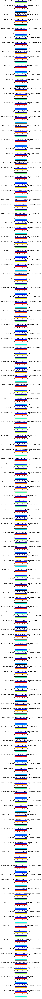

In [11]:
# counts = likelihood.signal.synthetic_data
# plot_one_pulse(counts, phase_mids, energy_mids, cm=cm.jet)

fig, axes = plt.subplots(len(counts),1, figsize=(4, len(counts)))
vmin = 0.
counts2019 = 24998635.0
sd_counts = []
total_counts = []

# vmax = np.max(counts)


for i, count, ax, label in zip(range(len(counts)), counts, axes, labels):
    total_count = np.sum(count)
    total_counts.append(total_count)
    sd_count = abs(counts2019-total_count)#**2
    sd_counts.append(sd_count)
    vmax = np.max(count)
    profile = ax.pcolormesh(phase_mids, energy_mids, count, cmap=cm.jet, vmin=vmin, vmax=vmax)
    ax.set_title(str(i)+', '+label+', counts='+str(total_count)+', diff='+str(sd_count))
    plt.colorbar(profile)

fig.tight_layout()

In [12]:
counts2019 = 24998635.0
sd_counts = []
total_counts = []

for count in counts:
    # print('total counts:',np.sum(count)) #cutting off half of data to measure total counts since phase goes up to 2.
    total_count = np.sum(count)
#     print(total_count)
    total_counts.append(total_count)
    sd_count = abs(counts2019-total_count)#**2
    sd_counts.append(sd_count)
    print(sd_count)

702054.0
715185.0
762689.0
783704.0
826341.0
838091.0
317287.0
343437.0
472688.0
510617.0
604830.0
646494.0
118044.0
67432.0
133391.0
197422.0
354618.0
415579.0
2906055.0
2917689.0
2963358.0
2974811.0
3016482.0
3027638.0
2572254.0
2598857.0
2715115.0
2746918.0
2826305.0
2864890.0
2203761.0
2237958.0
2430861.0
2476199.0
2621500.0
2678746.0
5358844.0
5370706.0
5415360.0
5422331.0
5458456.0
5469526.0
5082932.0
5096407.0
5193414.0
5231328.0
5300231.0
5337772.0
4754370.0
4791162.0
4962671.0
4998473.0
5122345.0
5174869.0
2549853.0
2536130.0
2465770.0
2455575.0
2390055.0
2379684.0
3019288.0
2981782.0
2820991.0
2781032.0
2663131.0
2615398.0
3545993.0
3484965.0
3229265.0
3148432.0
2951885.0
2881316.0
332365.0
312838.0
262589.0
240558.0
195316.0
180833.0
735370.0
699953.0
558742.0
527178.0
420915.0
385564.0
1187111.0
1135738.0
897564.0
844982.0
669137.0
603251.0
2129151.0
2143227.0
2186289.0
2204787.0
2242471.0
2261269.0
1791609.0
1820883.0
1937718.0
1971955.0
2062529.0
2102537.0
1407061.0
14592

In [13]:
# n_energies = len(energy_mids)

# summed_counts = counts[0].sum(axis=0)

# (A1, p1, c1), perr = fitsin(phase_mids, summed_counts)
# y=sinfunc(phase_mids, A1, p1, c1)

# fig, ax = plt.subplots()

# ax.plot(phase_mids, y, label='fit')
# ax.plot(phase_mids,summed_counts, label='data')
# ax.legend()

# summed_phase = p1-np.pi

In [14]:
# (A, p, c, A2, p2) = fit2sin(phase_mids, summed_counts)
# y2=sin2func(phase_mids, A, p, c, A2, p2)

# fig, ax = plt.subplots()

# ax.plot(phase_mids, y2, label='fit')
# ax.plot(phase_mids, summed_counts, label='data')
# ax.legend()

# summed_phase = p1-np.pi

In [15]:
# n_plots = n_energies #  n_plots = 2 #  
# fig, axes = plt.subplots(n_plots, figsize=(5,2*n_plots))

# fit_amplitudes = []
# fit_phases = []
# fit_constants = []
# fit_errors = np.empty((n_plots, 3))

# for i in range(n_plots):
#     counts_slice = counts[i] 
#     (A1, p1, c1), perr = fitsin(phase_mids, counts_slice)
#     fit_amplitudes.append(A1)
#     fit_phases.append(p1)
#     fit_constants.append(c1)
#     fit_errors[i] = perr
#     y=sinfunc(phase_mids, A1, p1, c1)

#     axes[i].plot(phase_mids, y)
#     axes[i].plot(phase_mids,counts_slice)
#     axes[i].set_title(f' energy: {energy_mids[i]:.2f} keV')
    
# plt.tight_layout()

In [16]:
# Make fits

n_energies = len(energy_mids)

fit_amplitudess = []
fit_phasess = []
fit_constantss = []
fit_errorss = []

for count in counts:
    fit_amplitudes = []
    fit_phases = []
    fit_constants = []
    fit_errors = np.empty((n_energies, 3))
    for i in range(n_energies):
        counts_slice = count[i] 
        (A1, p1, c1), perr = fitsin(phase_mids, counts_slice)
        fit_amplitudes.append(A1)
        fit_phases.append(p1)
        fit_constants.append(c1)
        fit_errors[i] = perr
    fit_amplitudess.append(fit_amplitudes)
    fit_phasess.append(fit_phases)
    fit_constantss.append(fit_constants)
    fit_errorss.append(fit_errors)

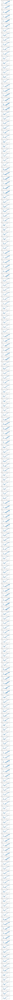

In [23]:
fig, axes = plt.subplots(len(counts),1,figsize=(4, 2*len(counts)))
for i, ax, fit_amplitudes, fit_constants, label in zip(range(len(counts)), axes, fit_amplitudess, fit_constantss, labels):
    ax.semilogy(energy_mids, abs(np.asarray(fit_amplitudes)/fit_constants), label=label)
    ax.semilogy([1, 2], [3.5e-2, 5.5e-2], 'x')
    ax.set_title(str(i)+', '+label)
    ax.set_xlabel('E keV')
    ax.set_ylabel('sinus amplitude in counts/constant component')
    ax.set_ylim([7e-3,2e-1])
    ax.grid()

fig.tight_layout()

In [18]:
pfs = [] # pulse fraction
pfs_1kev = []
pfs_2kev = []
data2019 = [3.5e-2, 5.5e-2]

for fit_amplitudes, fit_constants, label in zip(fit_amplitudess, fit_constantss, labels):
    pf=abs(np.asarray(fit_amplitudes)/fit_constants)
    pfs.append(pf)
    pfs_1kev.append(pf[80])
    pfs_2kev.append(pf[180])

# sd_1kev = abs(np.asarray(pfs_1kev)-data2019[0])**2
# sd_2kev = abs(np.asarray(pfs_2kev)-data2019[1])**2

dm_1kev = abs(np.log(np.asarray(pfs_1kev)/data2019[0]))
dm_2kev = abs(np.log(np.asarray(pfs_2kev)/data2019[1]))

dm_combined = dm_1kev+dm_2kev


In [19]:
for item in dm_combined:
    print(item)

3.0140669898672683
2.717170732436787
2.469064197268233
3.01513475714009
2.1649453954420674
2.6314685675851166
1.4812479049263143
0.7458414144644012
1.1777535068030847
1.4603882223494995
1.8342501072692592
1.9456952319345648
1.2117071494549754
1.1317188299351297
1.3678251581167205
1.1744713387320926
1.4336989708442123
1.3334380955904488
1.5326088542648708
2.62580284201952
2.0645404236655676
2.136506786610853
3.233170447353711
2.159044261733759
0.9572838664315846
1.2857207954274348
1.3979797383821282
1.2657225802732852
0.9417657182076816
1.3643231481080247
1.1753083543629201
1.196512252188511
1.0605142874935207
1.078906449109333
1.0488305360753056
1.3451497990783938
2.0274511216984665
1.6067636800386431
2.285527712941392
1.4549608076100513
2.7461466387016267
3.1634145607707693
0.938414224468991
1.1744218496724557
1.1547873643050497
0.9760194889886409
1.1735941328000583
1.9116917973643661
1.1457686079429508
0.8880473995906489
1.4071176265276542
1.2437745281304406
1.3408048362597116
1.3130

In [20]:
siness = []
for fit_amplitudes, fit_phases, fit_constants, count in zip(fit_amplitudess, fit_phasess, fit_constantss, counts):
    sines = np.empty(count.shape)
    for i, fit_amplitude, fit_phase, fit_constant in zip(range(n_energies), fit_amplitudes, fit_phases, fit_constants):
        sines[i]=sinfunc(phase_mids, fit_amplitude, fit_phase, abs(fit_amplitude))
    siness.append(sines)

In [21]:
backgrounds = []
for count, sines in zip(counts, siness):
    background = count-sines
    backgrounds.append(background)

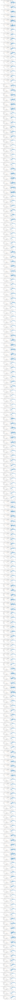

In [22]:
fig, axes = plt.subplots(len(counts), 2, figsize=(6, 2*len(counts)))
xlim = [0.8, 2]

for i, count, background, sines, label in zip(range(len(counts)), counts, backgrounds, siness, labels):
    average_count = count.sum(axis=1)
    average_background = background.sum(axis=1)
    average_sines = sines.sum(axis=1)
    axes[i,0].plot(energy_mids, average_background, label='background')
    axes[i,0].plot(energy_mids, average_count, label='total counts')
    axes[i,0].set_xlim(xlim)
    axes[i,0].legend()
    axes[i,1].plot(energy_mids, average_sines, label='pulsed')
    axes[i,1].set_xlim(xlim)
    axes[i,1].legend()
    axes[i,0].set_title(str(i)+', '+label)
    
fig.tight_layout()